In [11]:
import numpy as np
import scipy.io
import matplotlib.pyplot as plt
import pandas as pd
from notears.linear import notears_linear
import networkx as nx

In [4]:
def load_sims(i):
    path = f'sims/sim{i}.mat'
    sims = scipy.io.loadmat(path)
    ts = sims['ts'].reshape(
        int(sims['Nsubjects']),
        int(sims['Ntimepoints']),
        int(sims['Nnodes']),
    )
    nets = sims['net']
    return ts, nets

In [5]:
def tabulate_accuracy(ground_truth, estimate_graph, symm=False):
    if symm:
        ground_truth = (ground_truth + ground_truth.T) != 0
        estimate_graph = (estimate_graph + estimate_graph.T) != 0 
    
    estimates_where_positive_ground_truth = estimate_graph[ground_truth == 1]
    true_positives = np.sum(estimates_where_positive_ground_truth)
    positives = len(estimates_where_positive_ground_truth)

    estimates_where_gap_ground_truth = estimate_graph[ground_truth == 0]
    false_positives = np.sum(estimates_where_gap_ground_truth)
    negatives = len(estimates_where_gap_ground_truth)

    predicted_positives = np.sum(estimate_graph==1)

    diff = np.abs(ground_truth.astype(int) - estimate_graph.astype(int))
    diff = diff + diff.T
    diff[diff > 1] = 1
    shd = np.sum(diff)/2
    
    # metrics
    tpr = true_positives / positives
    fpr = false_positives / negatives
    tdr = true_positives / predicted_positives
    
    return {
        'tpr': tpr,
        'fpr': fpr,
        'tdr': tdr,
        'shd': shd
    }

In [6]:
def tune_params(ts, net):

    lambdas = [0, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1]
    losses = ['l2', 'poisson']

    true = (net - np.diag(np.diag(net)) != 0)
    acc = {}
    for lm in lambdas:
        for loss in losses:
            print(f'Running: lambda={lm}, loss func={loss}')
            out = notears_linear(
                X=ts,
                lambda1=lm,
                loss_type=loss,
                max_iter=1000
            )
            acc[(lm, loss)] = tabulate_accuracy(true, (np.abs(out) > 0.01))
    return acc
#plt.imshow(out, cmap='coolwarm', vmin=-1, vmax=1)
#plt.colorbar()

In [102]:
n_sims = 28

dfs = []
for sim in range(n_sims):
    print(f'\nSIMULATION {sim + 1}\n=======================')
    ts, nets = load_sims(sim + 1)
    n_sub = ts.shape[0]
    selected = np.random.permutation(n_sub)[:(n_sub // 25)]
    for s in selected:
        df_new = pd.DataFrame(tune_params(ts[s], nets[s]))
        df_new.index = pd.Index([(i, sim + 1, s) for i in df_new.index])
        dfs += [df_new]
df = pd.concat(dfs)
df.index = df.index.set_names(['Metric', 'Simulation', 'Subject'])
df = df.iloc[df.index.get_level_values('Metric') == 'shd']


SIMULATION 1
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson


<ipython-input-67-d5e4b1542dd2>:24: RuntimeWarning: invalid value encountered in long_scalars
  tdr = true_positives / predicted_positives


Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson

SIMULATION 2
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: 

Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson

SIMULATION 10
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: la

Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson

SIMULATION 19
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running

Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: lambda=0.1, loss func=l2
Running: lambda=0.1, loss func=poisson

SIMULATION 28
Running: lambda=0, loss func=l2
Running: lambda=0, loss func=poisson
Running: lambda=1e-05, loss func=l2
Running: lambda=1e-05, loss func=poisson
Running: lambda=0.0001, loss func=l2
Running: lambda=0.0001, loss func=poisson
Running: lambda=0.001, loss func=l2
Running: lambda=0.001, loss func=poisson
Running: lambda=0.01, loss func=l2
Running: lambda=0.01, loss func=poisson
Running: l

In [109]:
#for sim in range(n_sims):
df.mean(level='Simulation').idxmin(axis=1)

Simulation
1          (0.0, l2)
2          (0.0, l2)
3          (0.1, l2)
4          (0.1, l2)
5          (0.0, l2)
6          (0.0, l2)
7          (0.0, l2)
8     (0.0, poisson)
9          (0.0, l2)
10         (0.1, l2)
11    (0.0, poisson)
12         (0.0, l2)
13         (0.0, l2)
14         (0.0, l2)
15         (0.0, l2)
16         (0.0, l2)
17         (0.0, l2)
18         (0.0, l2)
19         (0.0, l2)
20         (0.0, l2)
21         (0.0, l2)
22         (0.1, l2)
23         (0.1, l2)
24         (0.1, l2)
25         (0.0, l2)
26    (0.0, poisson)
27         (0.1, l2)
28         (0.1, l2)
dtype: object

([], [])

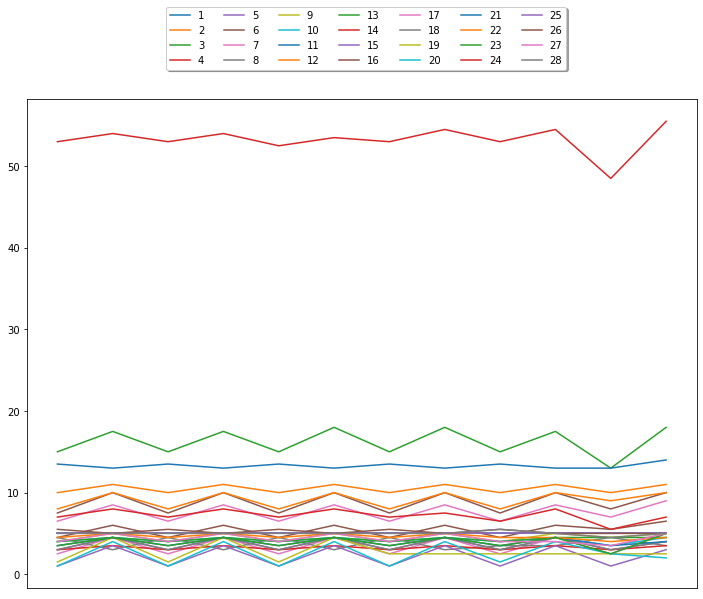

In [127]:
plt.figure(figsize=(12, 9))
plt.plot(df.mean(level='Simulation').values.T)
plt.legend(range(1, 29), bbox_to_anchor=(0.2, 1.05),
           ncol=7, fancybox=True, shadow=True)
plt.xticks([])

In [20]:
def run_notears_linear(ts, net, ids):
    sim_id, sub_id = ids
    true = (net - np.diag(np.diag(net)) != 0)
    acc = {}
    out = notears_linear(
        X=ts,
        lambda1=0,
        loss_type='l2',
        max_iter=1000
    )
    #print(out)
    acc = tabulate_accuracy(true, (np.abs(out) > 0.01))
    acc_symm = tabulate_accuracy(true, (np.abs(out) > 0.01), symm=True)
    G = nx.DiGraph(out)
    nx.draw(G, with_labels=True, node_color='#DDDDDD', node_size=999)
    plt.savefig(f'simulation_{sim_id+1}_{sub_id+1}_notears_linear.png')
    plt.figure()
    return acc, acc_symm


SIMULATION 1


<ipython-input-20-51a8d5f42a0f>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()



SIMULATION 2

SIMULATION 3

SIMULATION 4


/Users/annaxu/projects/fMRICausalReliability/notears/notears/linear.py:48: RuntimeWarning: invalid value encountered in multiply
  G_h = E.T * W * 2



SIMULATION 5

SIMULATION 6

SIMULATION 7

SIMULATION 8

SIMULATION 9

SIMULATION 10

SIMULATION 11

SIMULATION 12

SIMULATION 13


<ipython-input-5-d5e4b1542dd2>:24: RuntimeWarning: invalid value encountered in long_scalars
  tdr = true_positives / predicted_positives



SIMULATION 14

SIMULATION 15

SIMULATION 16

SIMULATION 17

SIMULATION 18

SIMULATION 19

SIMULATION 20

SIMULATION 21

SIMULATION 22

SIMULATION 23

SIMULATION 24

SIMULATION 25

SIMULATION 26

SIMULATION 27

SIMULATION 28


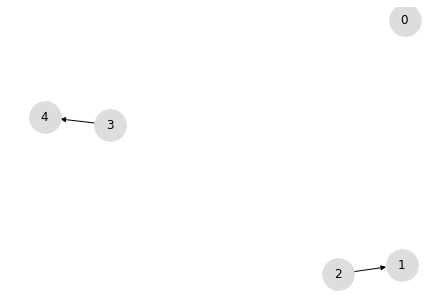

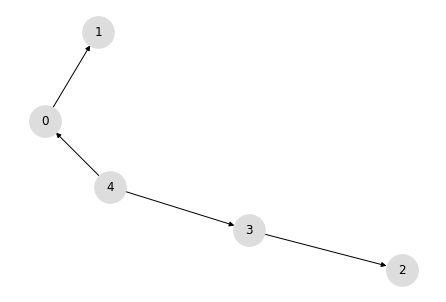

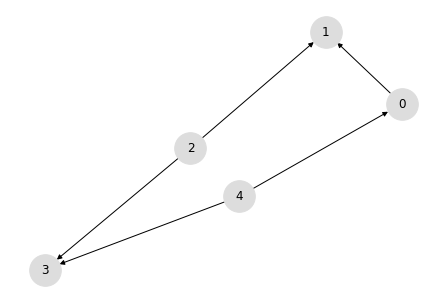

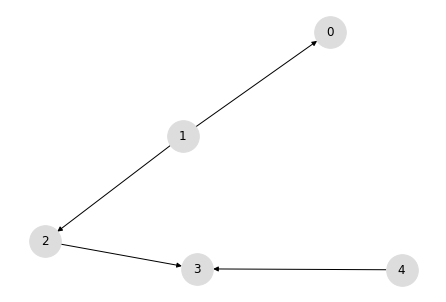

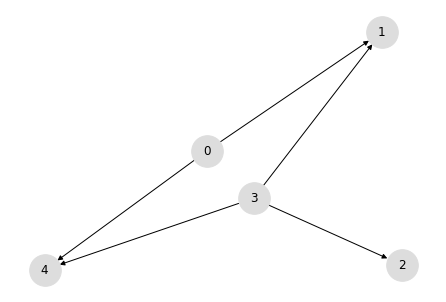

...

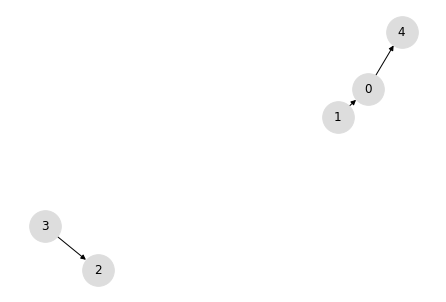

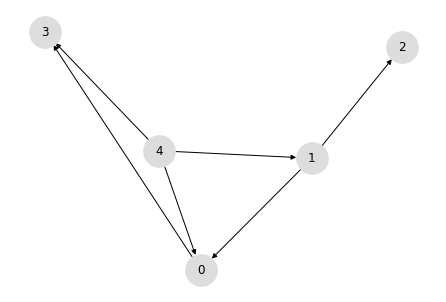

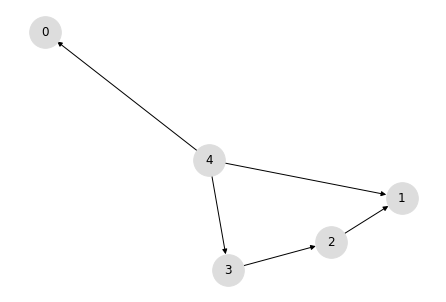

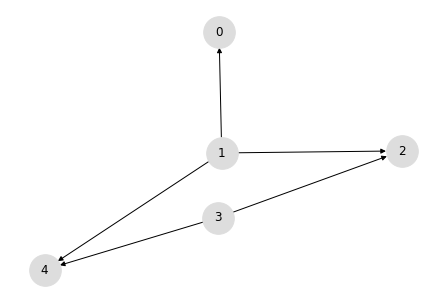

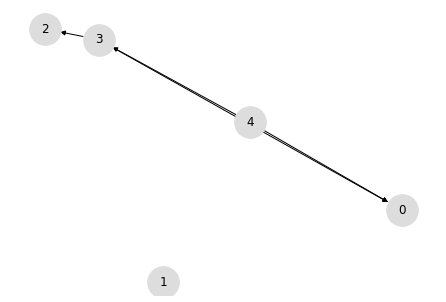

<Figure size 432x288 with 0 Axes>

In [21]:
n_sims = 28

accs = {
    'sim': [],
    'subj': [],
    'is_directed': [],
    'tpr': [],
    'fpr': [],
    'tdr': [],
    'shd': []
}
for sim in range(n_sims):
    print(f'\nSIMULATION {sim + 1}\n=======================')
    ts, nets = load_sims(sim + 1)
    n_sub = ts.shape[0]
    for s in range(n_sub):
        acc, acc_symm = run_notears_linear(ts[s], nets[s], (sim, s))
        accs['sim'] += [sim + 1, sim + 1]
        accs['subj'] += [s + 1, s + 1]
        accs['is_directed'] += ['directed', 'undirected']
        for k in acc.keys():
            accs[k] += [acc[k], acc_symm[k]]
df = pd.DataFrame(accs)

In [22]:
df

,sim,subj,is_directed,tpr,fpr,tdr,shd
0,1,1,directed,0.2,0.050000,0.50,4.0
1,1,1,undirected,0.4,0.000000,1.00,3.0
2,1,2,directed,0.2,0.150000,0.25,4.0
3,1,2,undirected,0.8,0.000000,1.00,1.0
4,1,3,directed,0.4,0.150000,0.40,3.0
...,...,...,...,...,...,...,...
2795,28,48,undirected,0.8,0.133333,0.80,2.0
2796,28,49,directed,0.4,0.150000,0.40,4.0
2797,28,49,undirected,0.8,0.133333,0.80,2.0
2798,28,50,directed,0.0,0.200000,0.00,6.0


In [36]:
df['method'] = 'notears'
df.to_csv('notears_graph_metrics.csv')

In [37]:
df2 = pd.read_csv("all_sims_subjs_graph_metrics.csv")

In [38]:
df2 = df2.drop(labels='Unnamed: 0', axis=1)

In [39]:
final_sims_subjs_graph_metrics = pd.concat([df, df2])
final_sims_subjs_graph_met

,sim,subj,is_directed,tpr,fpr,tdr,shd,method
0,1,1,directed,0.2,0.050000,0.500000,4.0,notears
1,1,1,undirected,0.4,0.000000,1.000000,3.0,notears
2,1,2,directed,0.2,0.150000,0.250000,4.0,notears
3,1,2,undirected,0.8,0.000000,1.000000,1.0,notears
4,1,3,directed,0.4,0.150000,0.400000,3.0,notears
...,...,...,...,...,...,...,...,...
8395,28,50,directed,0.8,0.100000,0.666667,2.0,pc
8396,28,50,undirected,1.0,0.133333,0.833333,1.0,ges
8397,28,50,directed,0.8,0.200000,0.500000,4.0,ges
8398,28,50,undirected,0.0,0.000000,NaN,5.0,arges
